In [7]:
import requests
import json

# Elasticsearch config
url = "https://127.0.0.1:9200/final_data/_search"
auth = ('elastic', 'elastic') 
headers = {'Content-Type': 'application/json'}

query = {
    "query": {
        "match_all": {}  
    },
    "size": 10000  
}


response = requests.get(
    url,
    headers=headers,
    auth=auth,
    json=query,
    verify=False  
)


if response.status_code == 200:
    data = response.json()
    
    all_documents = [hit["_source"] for hit in data["hits"]["hits"]]
    json_data = json.dumps(all_documents)

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/urllib3/connectionpool.py:1103: InsecureRequestWarning: Unverified HTTPS request is being made to host '127.0.0.1'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#tls-warnings
  warnings.warn(


In [8]:
json_data

'[{"metadata": {"post_id": "114421688068140391", "created_time": "2025-04-29T14:20:02.407Z", "url": "https://vive.im/@bocvip/114421688068140391", "language": "en", "region": "Global", "processed_at": "2025-05-13T12:11:46.130Z"}, "author": {"acct": "bocvip", "display_name": "BOCVIP", "profile_url": "https://vive.im/@bocvip", "domain": "vive.im", "join_date": "2024-05-12T00:00:00.000Z", "status": {"score": 0.99361, "label": "oppose tariff"}}, "content": {"text": "Trump Slams Amazon\\u2019s Tariff Labeling as \\u2018Hostile, Political\\u2019 Move https://www.bocvip.com/849925/trump-slams-amazons-tariff-labeling-as-hostile-political-move/ #stocks", "hashtags": ["#stocks"], "mentions": [], "word_count": 11}, "engagement": {"favorites": [], "reblogs": [{"acct": "markets@newsmast.community", "display_name": "Markets & Finance Feed", "created_time": "2023-12-21T00:00:00.000Z", "url": "https://newsmast.community/@markets", "Domain": "newsmast.community", "note": "Welcome to the Newsmast Markets

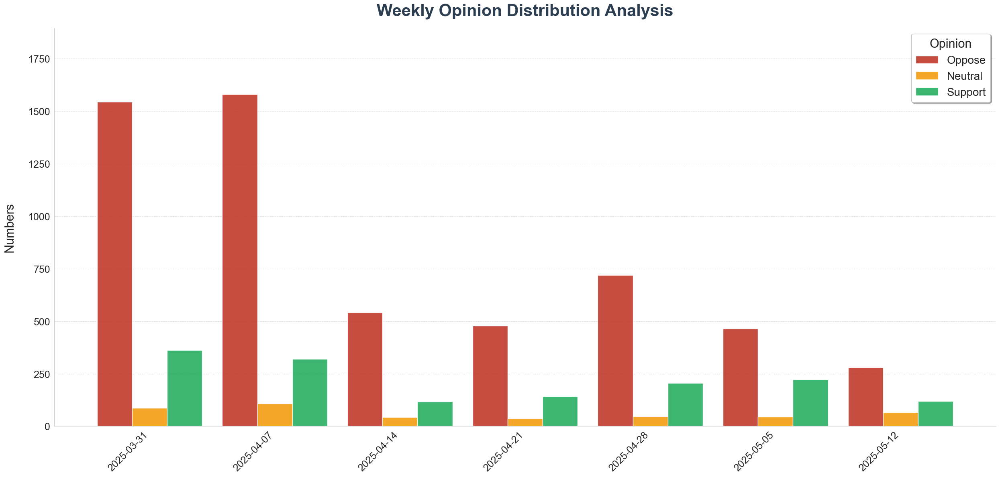

In [22]:
!pip install --quiet pandas matplotlib

import json
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime

def enhanced_analysis(json_str):
    try:
        # Data parsing
        data = json.loads(json_str)
        records = []
        
        for doc in data:
            # Enhanced field extraction
            label = str(doc.get('author', {}).get('status', {}).get('label', '')).lower()
            timestamp = doc.get('metadata', {}).get('created_time')
            
            # Opinion classification
            if 'oppose' in label:
                stance = 'Oppose'
            elif any(k in label for k in ['support', 'favor']):
                stance = 'Support'
            else:
                stance = 'Neutral'
            
            # Time process
            if timestamp:
                try:
                    dt = datetime.strptime(timestamp, '%Y-%m-%dT%H:%M:%S.%fZ')
                    week_start = dt - pd.offsets.Week(weekday=0)
                    records.append({'Week_start': week_start.strftime('%Y-%m-%d'), 'Opinion': stance})
                except:
                    continue
        
        # Create data analyze set
        df = pd.DataFrame(records)
        pivot = df.groupby(['Week_start', 'Opinion']).size().unstack().fillna(0)
        
        # Visualization
        sns.set_style("whitegrid")
        fig, ax = plt.subplots(figsize=(25, 12))
        bar_width = 0.28
        x = range(len(pivot.index))
        colors = {
            'Oppose': '#c0392b',  
            'Neutral': '#f39c12', 
            'Support': '#27ae60'   
        }
        for i, (stance, color) in enumerate(colors.items()):
            ax.bar([xi + i*bar_width for xi in x], 
                   pivot[stance], 
                   width=bar_width,
                   color=color,
                   edgecolor='white',
                   label=stance,
                   alpha=0.9)
        ax.set_xticks([xi + bar_width for xi in x])
        ax.set_xticklabels(pivot.index, rotation=45, ha='right', fontsize=18)
        ax.set_ylabel('Numbers', fontsize=22, labelpad=22)
        ax.tick_params(axis='y', which='major', labelsize=18) 
        ax.set_ylim(0, pivot.values.max()*1.2)
        ax.yaxis.grid(True, linestyle='--', alpha=0.6)
        ax.xaxis.grid(False)
        
        ax.set_title('Weekly Opinion Distribution Analysis', 
                    fontsize=30, pad=22, 
                    fontweight='bold', 
                    color='#2c3e50')
        
        legend = ax.legend(title='Opinion',
                          fontsize=20,
                          title_fontsize=22,
                          frameon=True,
                          shadow=True,
                          facecolor='white')
        legend.get_frame().set_edgecolor('#bdc3c7')
        
        for spine in ['top', 'right']:
            ax.spines[spine].set_visible(False)
        
        plt.tight_layout()
        plt.show()
    
    except Exception as e:
        print(f"Analysis failure：{str(e)}")

# 执行分析
if 'json_data' in globals():
    enhanced_analysis(json_data)
else:
    print("Error: Please run the data acquisition code first to generate the json data variable")

/var/folders/gg/p0jd2xm52c5g7v9vx7lbvccm0000gn/T/ipykernel_5426/2878411097.py:17: DeprecationWarning: invalid escape sequence '\_'
  text = bytes(text, 'utf-8').decode('unicode_escape', 'ignore')


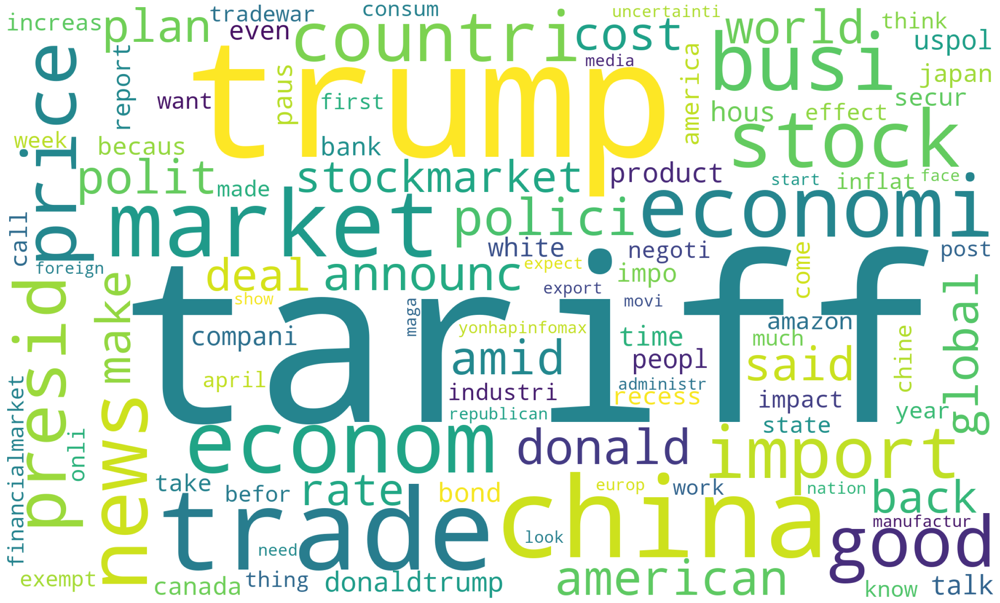

In [16]:
!pip install --quiet wordcloud matplotlib numpy nltk

import json
import re
import nltk
from nltk.stem import PorterStemmer
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings("ignore", category=UserWarning)

stemmer = PorterStemmer()

#data cleaning
def enhanced_clean(text):
    text = bytes(text, 'utf-8').decode('unicode_escape', 'ignore')    
    text = re.sub(r'https?://\S+|www\.\S+', '', text)
    text = re.sub(r'&\w+;', '', text)
    text = re.sub(r'[^\w\s@#-]', '', text)
    text = re.sub(r'\b\d+\w*', '', text)
    
    # word tokenize
    try:
        tokens = nltk.word_tokenize(text.lower())
    except:
        tokens = text.lower().split()  # 降级处理
    
    stems = [stemmer.stem(t) for t in tokens if len(t) > 3]
    return ' '.join(stems)

def robust_wordcloud(json_str):
    try:
        data = json.loads(json_str)
        unique_phrases = set()
        corpus = []
        
        for doc in data:
            if 'content' in doc and 'text' in doc['content']:
                cleaned = enhanced_clean(doc['content']['text'])
                if cleaned and hash(cleaned) not in unique_phrases:
                    corpus.append(cleaned)
                    unique_phrases.add(hash(cleaned))
        
        if not corpus:
            print("There is no valid text data. Please check the content.text field")
            return
        
        # stopwords
        custom_stop = STOPWORDS.union({
            'will', "'s", "n't", "'re", "'ve", "'ll", "'d", 
            'com', 'http', 'www', 'amp', 'u200b', 'rt'
        })
        
        # wordcloud
        wc = WordCloud(
            width=2000,
            height=1200,
            collocations=False,
            stopwords=custom_stop,
            colormap='viridis',
            max_words=100,
            regexp=r'\b[a-zA-Z]{4,}\b',
            normalize_plurals=True,
            background_color='white'
        ).generate(' '.join(corpus))
        
        # visualization
        plt.figure(figsize=(24, 16))
        plt.imshow(wc, interpolation='hermite')
        plt.axis('off')
        plt.tight_layout()
        plt.show()
        
    except Exception as e:
        print(f"error：{str(e)}")

if 'json_data' in globals():
    robust_wordcloud(json_data)
else:
    print("Error: Please run the data acquisition code first to generate the json data variable")

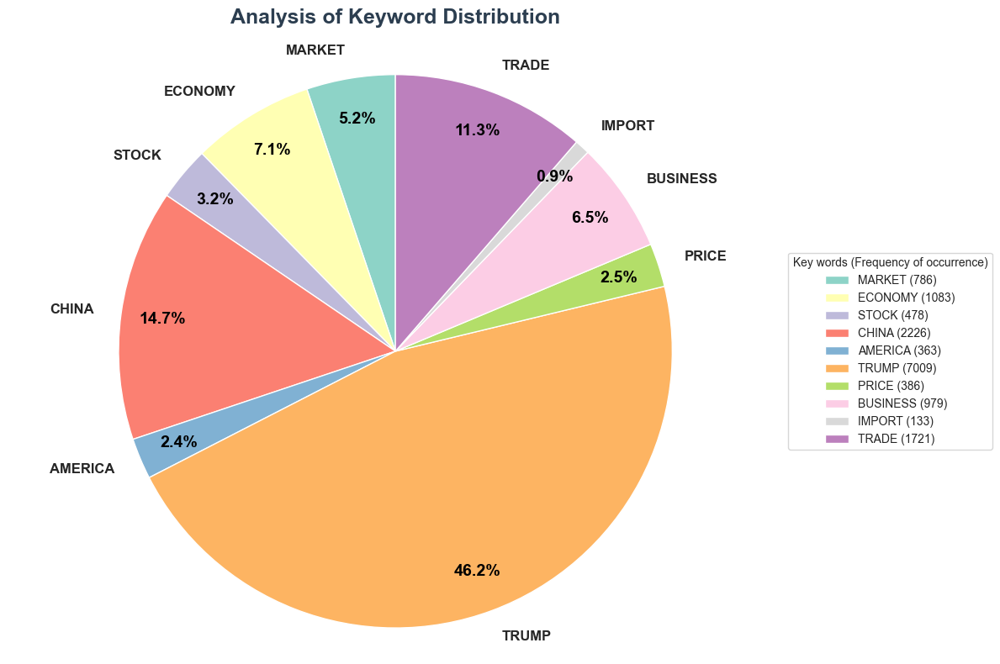

In [18]:
import matplotlib.pyplot as plt
from collections import defaultdict

# keywords
keywords = {
    'market', 'trade', 'trump', 'stock', 'economy',
    'china', 'america', 'price', 'import', 'business'
}

# countkeywords
def count_keywords(json_str):
    try:
        data = json.loads(json_str)
        counter = defaultdict(int)
        
        for doc in data:
            text = doc.get('content', {}).get('text', '').lower()
            
            for word in keywords:
                counter[word] += len(re.findall(rf'\b{word}\b', text))
        
        # 0 filter
        return {k:v for k,v in counter.items() if v > 0}
    
    except:
        return {}

def generate_pie_chart(freq_dict):
    labels = [k.upper() for k in freq_dict.keys()]
    sizes = list(freq_dict.values())
    
    if not sizes:
        print("does not match any keywords")
        return
    
    colors = ['#8dd3c7','#ffffb3','#bebada','#fb8072','#80b1d3',
              '#fdb462','#b3de69','#fccde5','#d9d9d9','#bc80bd']
    
    fig, ax = plt.subplots(figsize=(12, 8))
    wedges, texts, autotexts = ax.pie(
        sizes,
        labels=labels,
        colors=colors[:len(labels)],
        autopct='%1.1f%%',
        startangle=90,
        pctdistance=0.85,
        textprops={'fontsize':12, 'fontweight':'bold'},
        wedgeprops={'linewidth':1, 'edgecolor':'white'}
    )
    
    plt.setp(autotexts, size=14, color='black')
    ax.axis('equal') 
    
    # Title
    plt.title('Analysis of Keyword Distribution', 
             fontsize=18, pad=20, 
             fontweight='bold', 
             color='#2c3e50')

    plt.legend(
        wedges,
        [f"{l} ({s})" for l,s in zip(labels, sizes)],
        title="Key words (Frequency of occurrence)",
        loc="center left",
        bbox_to_anchor=(1, 0, 0.5, 1)
    )
    
    plt.tight_layout()
    plt.show()

if 'json_data' in globals():
    frequency = count_keywords(json_data)
    if frequency:
        generate_pie_chart(frequency)
    else:
        print("No keyword matching was detected")
else:
    print("Error: Please run the data acquisition code first")

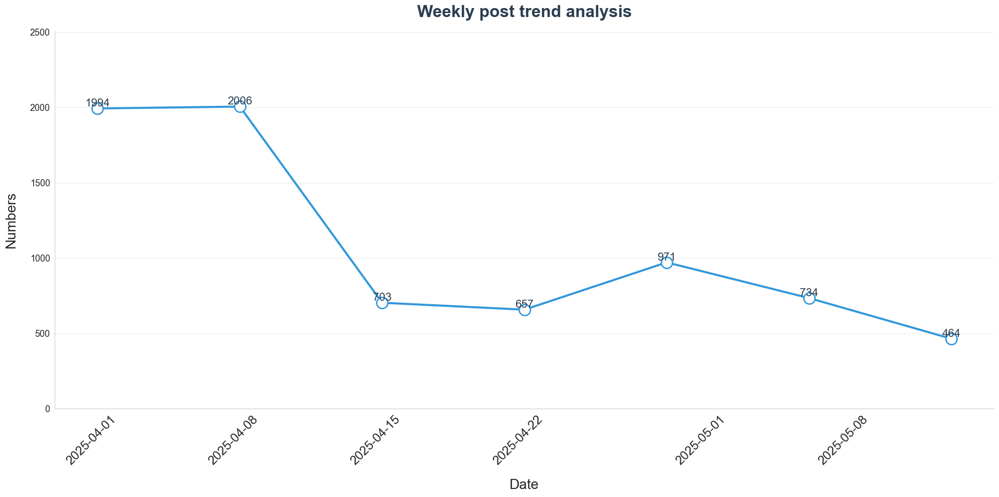

In [25]:
!pip install --quiet pandas matplotlib

import json
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime

def post_trend_analysis(json_str):
    try:
        data = json.loads(json_str)

        #time process
        post_dates = []
        for doc in data:
            ts = doc.get('metadata', {}).get('created_time')
            if ts:
                try:
                    dt = datetime.strptime(ts, '%Y-%m-%dT%H:%M:%S.%fZ')
                    week_start = dt - pd.offsets.Week(weekday=0)
                    post_dates.append(week_start.date())
                except Exception as e:
                    continue
        
        df = pd.DataFrame({'date': post_dates})
        weekly_counts = df.groupby('date').size()
        
        full_range = pd.date_range(
            start=weekly_counts.index.min(),
            end=weekly_counts.index.max(),
            freq='W-MON'
        )
        weekly_counts = weekly_counts.reindex(full_range, fill_value=0)
        
        # visualize
        plt.figure(figsize=(20, 10))
        sns.set_style("whitegrid")
        
        line = plt.plot(weekly_counts.index, 
                      weekly_counts.values,
                      marker='o',
                      markersize=16,
                      linewidth=3,
                      color='#3498db',
                      markerfacecolor='white',
                      markeredgewidth=2)
        
        # data labels
        for x, y in zip(weekly_counts.index, weekly_counts.values):
            if y > 0:
                plt.text(x, y+0.5, str(y),
                        ha='center',
                        va='bottom',
                        fontsize=16,
                        color='#2c3e50')
        
        plt.title('Weekly post trend analysis', 
                 fontsize=24, 
                 pad=20,
                 fontweight='bold',
                 color='#2c3e50')
        
        plt.xlabel('Date', 
                  fontsize=20, 
                  labelpad=17)
        plt.ylabel('Numbers', 
                  fontsize=20, 
                  labelpad=17)
        
        plt.xticks(rotation=45, 
                  ha='right',
                  fontsize=18)
        plt.yticks(fontsize=13)
        plt.ylim(0, weekly_counts.max()*1.25)
        
        plt.grid(axis='y', alpha=0.4)
        plt.grid(axis='x', visible=False)
        
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        
        plt.tight_layout()
        plt.show()
        
    except Exception as e:
        print(f"error：{str(e)}")

if 'json_data' in globals():
    post_trend_analysis(json_data)
else:
    print("Error: Please run the data acquisition code first")

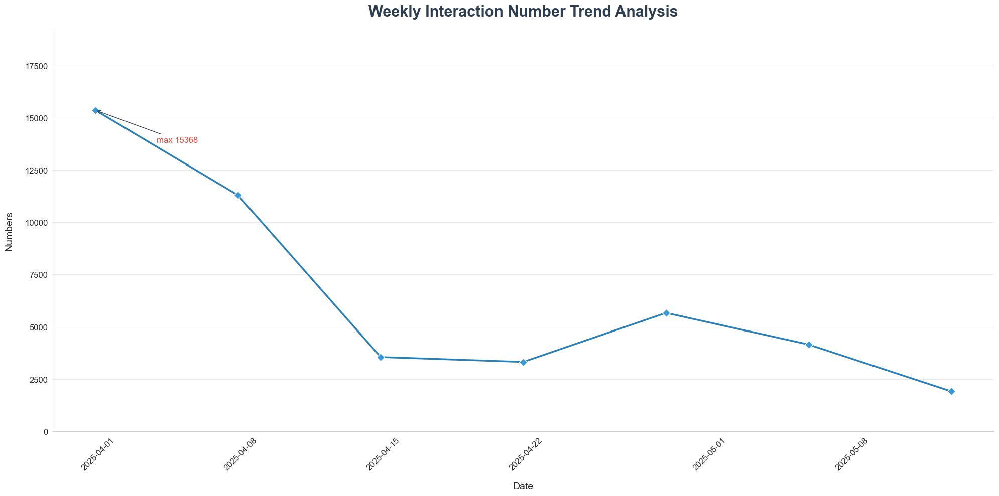

In [21]:
!pip install --quiet pandas matplotlib

import json
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime

def engagement_analysis(json_str):
    try:
        data = json.loads(json_str)
        
        weekly_engagement = {}
        for doc in data:
            # time analyze
            ts = doc.get('metadata', {}).get('created_time')
            if not ts:
                continue
                
            try:
                dt = datetime.strptime(ts, '%Y-%m-%dT%H:%M:%S.%fZ')
                week_start = dt - pd.offsets.Week(weekday=0)
                week_str = week_start.strftime('%Y-%m-%d')
            except:
                continue
                
            # count
            engagement = doc.get('engagement', {})
            count = len(engagement.get('favorites', [])) \
                  + len(engagement.get('reblogs', [])) \
                  + len(engagement.get('replies', []))
            
            weekly_engagement[week_str] = weekly_engagement.get(week_str, 0) + count
        
        if not weekly_engagement:
            print("There is no effective interaction data")
            return
        
        df = pd.DataFrame({
            'week': pd.to_datetime(list(weekly_engagement.keys())),
            'count': list(weekly_engagement.values())
        }).set_index('week').sort_index()
        
        full_range = pd.date_range(
            start=df.index.min(),
            end=df.index.max(),
            freq='W-MON'
        )
        df = df.reindex(full_range, fill_value=0)
        
        # visualization
        plt.figure(figsize=(20, 10))
        sns.set_style("whitegrid")
        
        line = plt.plot(df.index, 
                      df['count'],
                      marker='D',          
                      markersize=8,
                      linewidth=2.5,
                      color='#2980b9',    
                      markerfacecolor='#3498db', 
                      markeredgewidth=1,
                      markeredgecolor='white')
    
        max_point = df['count'].idxmax()
        plt.annotate(f'max {df["count"].max()}',
                    xy=(max_point, df['count'].max()),
                    xytext=(max_point + pd.Timedelta(days=3), df['count'].max()*0.9),
                    arrowprops=dict(arrowstyle='->', color='#2c3e50'),
                    fontsize=12,
                    color='#e74c3c')
        
        plt.title('Weekly Interaction Number Trend Analysis', 
                 fontsize=22, 
                 pad=20,
                 fontweight='bold',
                 color='#2c3e50')
        
        plt.xlabel('Date', 
                  fontsize=14, 
                  labelpad=15)
        plt.ylabel('Numbers', 
                  fontsize=14, 
                  labelpad=15)
        
        plt.xticks(rotation=45, ha='right', fontsize=12)
        plt.yticks(fontsize=12)
        plt.ylim(0, df['count'].max()*1.25)

        plt.grid(axis='y', alpha=0.4)
        plt.grid(axis='x', visible=False)
        
        ax = plt.gca()
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        
        plt.tight_layout()
        plt.show()
        
    except Exception as e:
        print(f"error：{str(e)}")

if 'json_data' in globals():
    engagement_analysis(json_data)
else:
    print("Error: Please run the data acquisition code first")

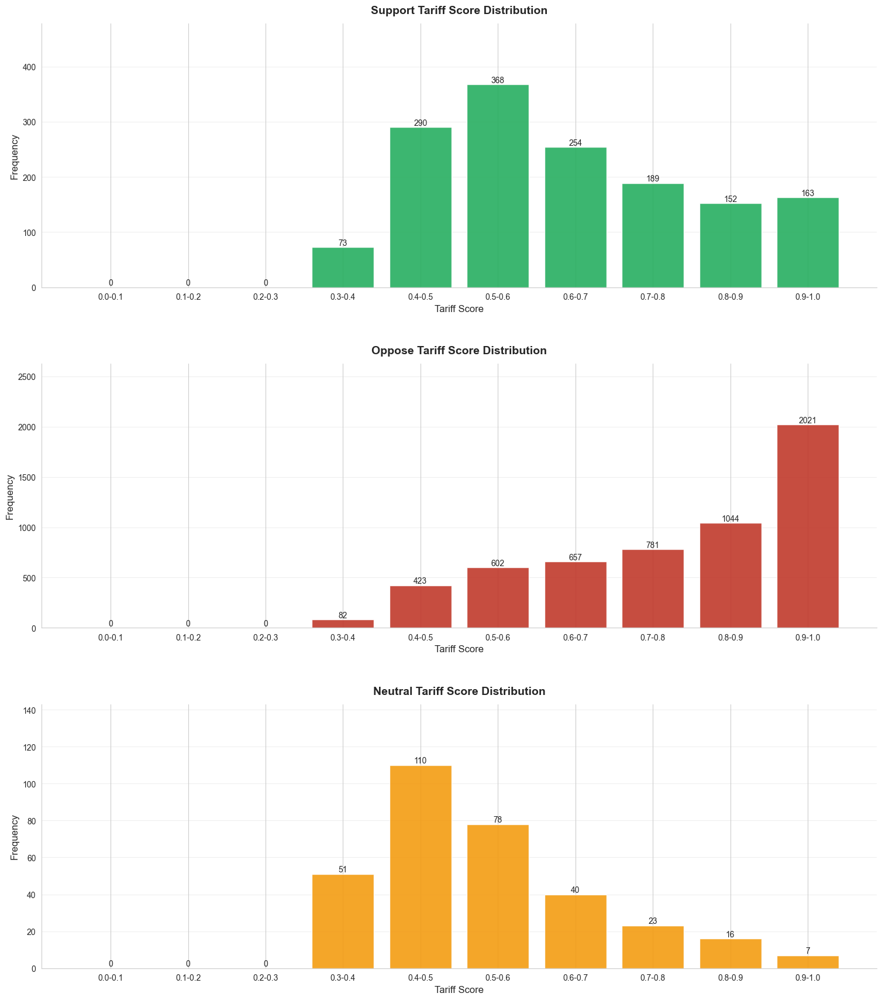

In [23]:
import json
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

#lower transform
def safe_lower(s):
    return str(s).lower() if s is not None else ''

def plot_tariff_distribution(json_str):
    try:
        data = json.loads(json_str)
        records = []
        
        for doc in data:
            author = doc.get('author', {}) or {}
            status = author.get('status', {}) or {}
        
            raw_label = status.get('label')
            score = status.get('score')
            
            if score is None or not (0 <= score <= 1):
                continue  

            label = safe_lower(raw_label)
            clean_label = 'neutral' 
            if 'oppose' in label:
                clean_label = 'oppose'
            elif any(k in label for k in ['support', 'favor']):
                clean_label = 'support'
            
            records.append({'label': clean_label, 'score': score})

        if not records:
            print("Insufficient valid data: No records containing score and label were found")
            print("Data verification suggestions:")
            print("Confirm that the author.status.score field exists and is a value between 0 and 1")
            print("Check whether the author.status.label field contains the position identifier")
            return
        
        df = pd.DataFrame(records)

        bins = np.linspace(0, 1, 11)
        labels = [f"{i/10:.1f}-{(i+1)/10:.1f}" for i in range(10)]

        fig, axes = plt.subplots(3, 1, figsize=(16, 18))
        positions = ['support', 'oppose', 'neutral']
        colors = ['#27ae60', '#c0392b', '#f39c12']
        
        for idx, stance in enumerate(positions):
            ax = axes[idx]
            subset = df[df['label'] == stance]
            
            if subset.empty:
                ax.text(0.5, 0.5, f'No Data for {stance}',
                       ha='center', va='center',
                       fontsize=14)
                ax.set_title(f"{stance.capitalize()} Tariff - no data effective", fontsize=12)
                continue

            hist_data = pd.cut(subset['score'], bins=bins, labels=labels).value_counts().sort_index()
  
            bars = ax.bar(hist_data.index, hist_data.values,
                         color=colors[idx],
                         edgecolor='white',
                         alpha=0.9)

            for bar in bars:
                height = bar.get_height()
                ax.text(bar.get_x() + bar.get_width()/2., 
                        height + 0.2,
                        f'{int(height)}',
                        ha='center', va='bottom',
                        fontsize=10)

            ax.set_title(f"{stance.capitalize()} Tariff Score Distribution", 
                        fontsize=14, pad=12, 
                        fontweight='bold')
            ax.set_xlabel('Tariff Score', fontsize=12)
            ax.set_ylabel('Frequency', fontsize=12)
            ax.set_ylim(0, hist_data.max()*1.3)
            ax.grid(axis='y', alpha=0.3)
            ax.spines['top'].set_visible(False)
            ax.spines['right'].set_visible(False)
        
        plt.tight_layout(pad=4.0)
        plt.show()
        
    except Exception as e:
        print(f"error：{str(e)}")
        if 'doc' in locals():
            print("last data sample：", doc)

if 'json_data' in globals():
    plot_tariff_distribution(json_data)
else:
    print("Error: Please run the data acquisition code first")